# Test to repliacate real images


In [1]:
import tifffile as tiff
from helpers.helpersGeneration import *
from helpers.helpersTracking import *

In [2]:
# Load the .tif file
image_3d = tiff.imread('real-data/70_01_7.tif')
analysis_lenght = image_3d.shape[0]
print(image_3d.shape)  # (slices, height, width) or sometimes (height, width) if it's 2D

(250, 170, 512)


In [ ]:
play_video(image_3d[:analysis_lenght], figsize=(24,8), no_borders=True)

vmin: 483 vmax: 12674 mean: 1352.13


In [4]:
frame0 = image_3d[0]
test_image =  frame0[0:200,0:200]

In [5]:

%load_ext autoreload
%reload_ext autoreload
%autoreload 2

coordinates, filtered_image = detect_particles(frame0.astype(np.float32))
# Print number of detected particles
print(f"Detected {len(coordinates)} particles")

# Access first particle coordinates (y, x)
if len(coordinates) > 0:
    print(f"First particle at y={coordinates[0][0]}, x={coordinates[0][1]}")

Detected 169 particles
First particle at y=45, x=168


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Detected 20 particles
First particle at y=46, x=168


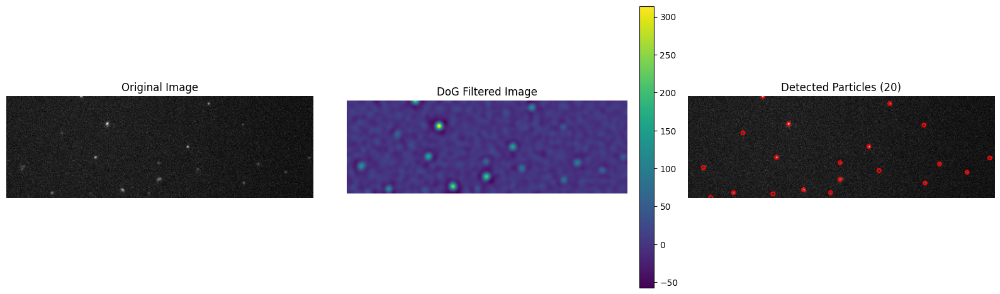

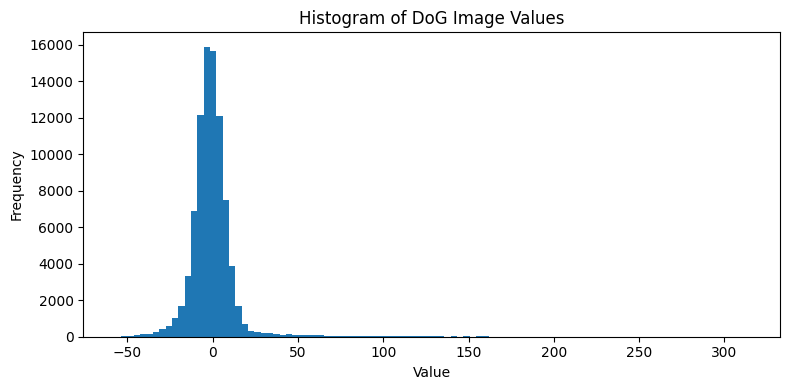

In [6]:
from helpersTracking import *
%load_ext autoreload
%reload_ext autoreload
%autoreload 2

# Detect particles
coordinates, dog_image = detect_particles(
    frame0.astype(np.float32), 
    sigma1=5.0,  # Adjust based on your particle size
    sigma2=7.0,  # Should be larger than sigma1
    min_distance=10  # Minimum separation between particles
)
# Print number of detected particles
print(f"Detected {len(coordinates)} particles")

# Access first particle coordinates (y, x)
if len(coordinates) > 0:
    print(f"First particle at y={coordinates[0][0]}, x={coordinates[0][1]}")
# Visualize results
visualize_dog_detection(frame0, dog_image, coordinates)

In [7]:
from helpersTracking import *
%load_ext autoreload
%reload_ext autoreload
%autoreload 2

# Load your image sequence (example)
image_sequence = image_3d[:analysis_lenght,:,:].astype(np.float32)

# Run the analysis
tracks, detections, filtered_images = analyze_microscopy_sequence(
    image_sequence,
    sigma1=5.0,                  # Adjust for your particle size
    sigma2=7.0,                  # Adjust for your particle size
    threshold_percentage=0.1,    # Adjust based on signal-to-noise ratio
    min_distance=3,              # Minimum distance between particles
    max_linking_distance=10,     # Maximum movement between frames
    min_track_length=3,          # Minimum track length to keep
    visualize=True,
    verbose=False,
    #output_prefix="experiment1"  # Optional: save results with this prefix
)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Tracking complete: 8079 total tracks, 954 tracks with ≥3 frames


Animation size has reached 21002577 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [8]:
tracks_stats = {k: len(tracks[k]) for k in tracks.keys()}
print(tracks_stats)

{0: 34, 1: 189, 2: 22, 3: 14, 4: 9, 5: 83, 6: 194, 7: 28, 8: 138, 9: 3, 10: 28, 11: 22, 12: 672, 13: 29, 14: 14, 15: 3, 16: 82, 17: 6, 18: 4, 19: 3, 20: 10, 21: 4, 22: 3, 23: 9, 24: 9, 25: 3, 26: 8, 27: 12, 28: 3, 29: 9, 30: 7, 31: 15, 32: 4, 33: 22, 34: 5, 35: 3, 36: 5, 37: 22, 38: 57, 39: 11, 40: 26, 41: 21, 42: 3, 43: 40, 44: 33, 45: 3, 46: 3, 47: 3, 48: 19, 49: 5, 50: 4, 51: 11, 52: 5, 53: 3, 54: 3, 55: 8, 56: 29, 57: 35, 58: 4, 59: 62, 60: 7, 61: 18, 62: 3, 63: 3, 64: 9, 65: 27, 66: 6, 67: 9, 68: 5, 69: 3, 70: 7, 71: 3, 72: 16, 73: 6, 74: 14, 75: 8, 76: 8, 77: 20, 78: 4, 79: 73, 80: 11, 81: 6, 82: 7, 83: 3, 84: 7, 85: 48, 86: 4, 87: 5, 88: 98, 89: 95, 90: 10, 91: 9, 92: 45, 93: 52, 94: 13, 95: 3, 96: 3, 97: 3, 98: 13, 99: 9, 100: 8, 101: 5, 102: 47, 103: 4, 104: 3, 105: 28, 106: 4, 107: 9, 108: 8, 109: 4, 110: 9, 111: 19, 112: 17, 113: 24, 114: 3, 115: 9, 116: 3, 117: 5, 118: 14, 119: 8, 120: 8, 121: 5, 122: 6, 123: 7, 124: 56, 125: 3, 126: 5, 127: 3, 128: 28, 129: 37, 130: 3, 131

In [9]:
patch_size = 9
patches = extract_particle_patches(image_3d, tracks, patch_size=patch_size)

# Accessing one example patch
first_track_id = list(patches.keys())[0]
example_patch = patches[first_track_id][0]
print(example_patch.shape)  # (7, 7)
print(np.mean(patches[6]))
# Save as multi-page .tif

play_video(patches[16])

(9, 9)
1962.735649739086
vmin: 633 vmax: 9752 mean: 2113.11


In [10]:

patches = extract_particle_patches(image_3d, tracks, patch_size=patch_size)
df_tracks = tracks_to_dataframe(tracks, patches, patch_size)
df_tracks.tail(22)


c:\Users\Silly Emilien\Documents\EPFL\Ma2\Project\SPT_VisionModel\helpersTracking.py:584: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, _ = curve_fit(symmetrical_gaussian, (x, y), patch.ravel(), p0=initial_guess)


particle 19 could not be located on frame 8
particle 88 could not be located on frame 88
particle 96 could not be located on frame 90
particle 120 could not be located on frame 132
particle 124 could not be located on frame 146
particle 198 could not be located on frame 192
particle 202 could not be located on frame 687
particle 205 could not be located on frame 191
particle 205 could not be located on frame 192
particle 207 could not be located on frame 198
particle 213 could not be located on frame 200
particle 218 could not be located on frame 204
particle 247 could not be located on frame 254
particle 254 could not be located on frame 234
particle 254 could not be located on frame 238
particle 261 could not be located on frame 238
particle 296 could not be located on frame 272
particle 323 could not be located on frame 357
particle 327 could not be located on frame 328
particle 364 could not be located on frame 387
particle 414 could not be located on frame 451
particle 424 could n

nbr_frames    x    y   x_refined   y_refined  psf_size  \
track_id frame                                                           
948      997             6  401  151  401.021088  150.854206  1.362293   
         998             6  402  151  401.801462  150.626976  1.182422   
         999             6  401  151  400.594682  150.864744  1.446958   
949      994             3  251  144  251.468904  145.111757  1.230119   
         995             3  252  144  251.503200  144.824993  1.337618   
         996             3  252  145  251.615730  145.658963  1.117888   
950      995             5  184   80  184.672483   79.690613  0.972379   
         996             5  184   80  185.271025   79.055077  0.814213   
         997             5  185   78  185.005513   79.144642  1.025996   
         998             5  185   79  184.265776   79.926405  0.727023   
         999             5  186   80  184.890126   79.840440  0.894257   
951      996             4  125    0  125.188468    1.367788  2.171306   
         997             4  125    0  125.199803    0.707750  1.210882   
         998             4  125    0  125.461935    0.550639  0.999709   
         999             4  125    0  125.001879    1.628346  2.420103   
952      996             4   92   61   92.444212   60.548420  1.420264   
         997             4   93   60   92.701888   60.383681  1.118403   
         998             4   93   61   92.694524   60.989393  1.384691   
         999             4   92   60   92.734958   60.061567  1.536336   
953      997             3  345   72  347.771527   72.261635  0.859587   
         998             3  351   69  350.578518   69.625416  0.271895   
         999             3  347   70  346.370700   69.986308  0.216516   

                max_intensity  displacement  mean_displacement  mean_psf_size  \
track_id frame                                                                  
948      997             4351      0.358419           0.551755       1.307868   
         998             4664      0.812784           0.551755       1.307868   
         999             3669      1.229980           0.551755       1.307868   
949      994             2632      0.000000           0.376778       1.228542   
         995             2937      0.288807           0.376778       1.228542   
         996             2497      0.841528           0.376778       1.228542   
950      995             3115      0.000000           0.571948       0.886774   
         996             3774      0.873017           0.571948       0.886774   
         997             3821      0.280212           0.571948       0.886774   
         998             5013      1.076273           0.571948       0.886774   
         999             3735      0.630240           0.571948       0.886774   
951      996             6408      0.000000           0.534385       1.700500   
         997             6548      0.660135           0.534385       1.700500   
         998             7092      0.305609           0.534385       1.700500   
         999             5298      1.171795           0.534385       1.700500   
952      996             4225      0.000000           0.460075       1.364924   
         997             4520      0.305836           0.460075       1.364924   
         998             3354      0.605757           0.460075       1.364924   
         999             2963      0.928707           0.460075       1.364924   
953      997             2137      0.000000           2.691363       0.449333   
         998             2357      3.850824           2.691363       0.449333   
         999             2007      4.223266           2.691363       0.449333   

                max_intensity_over_track  mean_max_intensity_over_track  \
track_id frame                                                            
948      997                        4664                    4248.833333   
         998                        4664                    4248.8333

In [11]:
# Sort the DataFrame by 'mean_displacement'
sorted_tracks = df_tracks.sort_values(by='mean_displacement', ascending=True)
# Drop duplicates based on the first level of the MultiIndex (track_id)
sorted_unique_tracks = sorted_tracks.reset_index().drop_duplicates(subset='track_id').set_index(['track_id', 'frame'])

sorted_unique_tracks.head(30)

,,nbr_frames,x,y,x_refined,y_refined,psf_size,max_intensity,displacement,mean_displacement,mean_psf_size,max_intensity_over_track,mean_max_intensity_over_track,std_max_intensity_over_track
track_id,frame,,,,,,,,,,,,,
18,6,4,254,112,253.594762,112.189774,1.086762,5102,0.126747,0.098986,1.323303,5102,3403.250000,1162.845182
561,619,3,466,63,465.384309,61.908780,1.455794,2785,0.000000,0.108742,1.076346,3081,2846.333333,210.801645
398,427,3,209,159,208.737163,159.203325,1.115415,3299,0.000000,0.116335,1.159363,3661,3432.666667,198.701619
215,200,4,252,145,251.517644,144.812343,0.981559,3504,0.118164,0.124396,0.926332,3504,2948.750000,379.248709
384,413,3,465,60,465.393591,61.749637,1.124772,2578,0.171138,0.127604,1.137078,2578,2412.666667,149.500279
617,701,4,240,147,239.347152,147.214792,1.034264,3338,0.107641,0.148232,1.114022,4066,3360.750000,624.942331
397,427,3,465,61,465.437676,61.315840,1.090806,3158,0.302811,0.159293,1.193514,3158,2616.333333,471.597639
301,279,3,466,61,465.504215,61.778867,0.966548,2667,0.229103,0.165535,0.874491,3403,2970.333333,384.667822
268,244,3,211,86,210.139903,84.399876,0.949405,2862,0.360987,0.173378,0.935030,2965,2814.333333,179.316294


## Comparison of model and msd prediction


In [12]:
# Load training results
import torch
results = torch.load("training_results_mult2.pth",map_location=torch.device('cpu'))
model_weights = results["model_weights"]

from trainSettingsMult import *

models, optimizers, schedulers = getModels()

# Load model weights
for name, model in models.items():
    if name in model_weights:
        model.load_state_dict(model_weights[name])
        model.eval()  # Set to evaluation mode
        print(f"Loaded weights for {name}")
    else:
        print(f"Warning: No saved weights found for {name}")

deepcnn1 = models["trans_poisson_noise"]
deepcnn2 = models["trans_gaussian_noise"]
resnet = models["resnet_poisson_noise"]


Loaded weights for trans_no_noise
Loaded weights for resnet_no_noise
Loaded weights for trans_gaussian_noise
Loaded weights for resnet_gaussian_noise
Loaded weights for trans_poisson_noise
Loaded weights for resnet_poisson_noise
Loaded weights for trans_gauss_filter
Loaded weights for resnet_gauss_filter
Loaded weights for trans_RL_2
Loaded weights for resnet_RL_2
Loaded weights for trans_RL_5
Loaded weights for resnet_RL_5
Loaded weights for trans_RL_10
Loaded weights for resnet_RL_10


In [13]:
def add_model_prediction_to_dataframe(df_tracks, patches, model, column_name):
    """
    Apply a vision model to each track's image sequence and store the result in a new column.

    Parameters:
    -----------
    df_tracks : pd.DataFrame
        Multi-indexed DataFrame with index (track_id, frame).
    patches : dict
        Dictionary mapping track_id to a list of image patches (per frame).
    model : callable
        Model that takes a video tensor (e.g. torch.Tensor of shape [T, C, H, W]) and returns a prediction.
    column_name : str
        Name of the new column to store the per-track prediction.

    Returns:
    --------
    df_tracks : pd.DataFrame
        Updated DataFrame with an added column for the model prediction.
    """
    import numpy as np

    # Store predictions
    predictions = {}

    for track_id in df_tracks.index.get_level_values(0).unique():
        # Retrieve the image sequence (list of patches)
        frames = patches[track_id]  # list of np arrays, one per frame

        # Preprocess into tensor-like format as required by your model
        chosen_video,_ = normalize_images(np.stack(frames).astype(np.float32), background_mean, background_sigma, part_mean)  # shape: [T, H, W] or [T, C, H, W] depending on model
        # Add channel dimension if needed
        if chosen_video.ndim == 3:
            chosen_video = torch.Tensor(chosen_video[np.newaxis,:, :, :])  # [1, T, H, W]

        
        pred = -1

        vid_frames = chosen_video.shape[1]

        if(vid_frames > nFrames):
            predictions_video = []
            for i in range(vid_frames-nFrames):
                vid = chosen_video[:, i:i+nFrames]  # [1, nFrames, H, W]
                with torch.no_grad():
                    p = model(vid).item()  # assumes model outputs a scalar per track
                    predictions_video.append(p)

            pred = np.array(predictions_video).mean()

        else:   
            # Get prediction
            with torch.no_grad():
                pred = model(chosen_video).item()  # assumes model outputs a scalar per track
        predictions[track_id] = pred

    # Assign predictions to all rows in df_tracks
    df_tracks[column_name] = df_tracks.index.get_level_values('track_id').map(predictions)

    return df_tracks


df_tracks = add_model_prediction_to_dataframe(df_tracks, patches, resnet, column_name="D_resnet")
df_tracks = add_model_prediction_to_dataframe(df_tracks, patches, deepcnn1, column_name="D_cnn1")
df_tracks = add_model_prediction_to_dataframe(df_tracks, patches, deepcnn2, column_name="D_cnn2")

df_tracks.head(5)


nbr_frames    x   y   x_refined  y_refined  psf_size  \
track_id frame                                                         
0        0              34  168  46  167.962324  45.536312  1.553222   
         1              34  168  49  167.495723  48.282724  1.346356   
         2              34  165  47  165.232826  46.988272  1.699849   
         3              34  171  48  171.897365  47.919636  1.338876   
         4              34  175  50  175.489543  49.812300  2.200470   

                max_intensity  displacement  mean_displacement  mean_psf_size  \
track_id frame                                                                  
0        0               7746      0.000000           3.040628       1.570906   
         1               9864      2.785767           3.040628       1.570906   
         2               6454      2.606973           3.040628       1.570906   
         3               7019      6.729303           3.040628       1.570906   
         4               5683      4.060286           3.040628       1.570906   

                max_intensity_over_track  mean_max_intensity_over_track  \
track_id frame                                                            
0        0                         12410                    8460.911765   
         1                         12410                    8460.911765   
         2                         12410                    8460.911765   
         3                         12410                    8460.911765   
         4                         12410                    8460.911765   

                std_max_intensity_over_track  D_resnet    D_cnn1    D_cnn2  
track_id frame                                                              
0        0                       2017.403422  1.197209  0.851324  0.798295  
         1                       2017.403422  1.197209  0.851324  0.798295  
         2                       2017.403422  1.197209  0.851324  0.798295  
         3                       2017.403422  1.197209  0.851324  0.798295  
         4                       2017.403422  1.197209  0.851324  0.798295

Correlation between mean_displacement and each model prediction:
D_resnet    0.167021
D_cnn1      0.400456
D_cnn2      0.486148
Name: mean_max_intensity_over_track, dtype: float64


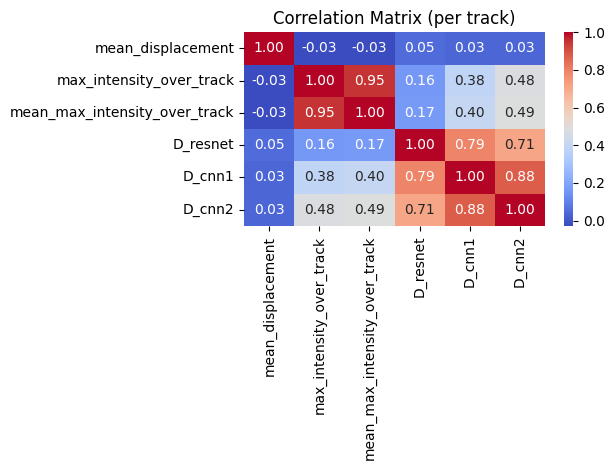

In [14]:

def computeCorrforFeaturesPlotCorr(df, features, index='track_id'):

    # Step 1: Reset index to access 'track_id' as a column
    df_per_frame = df.reset_index()

    # Step 2: Drop duplicates to get one row per track (since these values are constant within each track)
    df_per_track = df_per_frame.drop_duplicates(subset='track_id')[
        features
    ].set_index('track_id')

    # Step 3: Compute Pearson correlation matrix
    correlation_matrix = df_per_track.corr()

    # Step 4: Extract correlations with 'mean_displacement'
    correlation_with_disp = correlation_matrix['mean_max_intensity_over_track'][['D_resnet', 'D_cnn1', 'D_cnn2']]

    print("Correlation between mean_displacement and each model prediction:")
    print(correlation_with_disp)
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
    plt.title("Correlation Matrix (per track)")
    plt.tight_layout()
    plt.show()
    return correlation_matrix

corr_matrix = computeCorrforFeaturesPlotCorr(df_tracks, ['track_id', 'mean_displacement', 'max_intensity_over_track','mean_max_intensity_over_track' ,'D_resnet', 'D_cnn1', 'D_cnn2'])


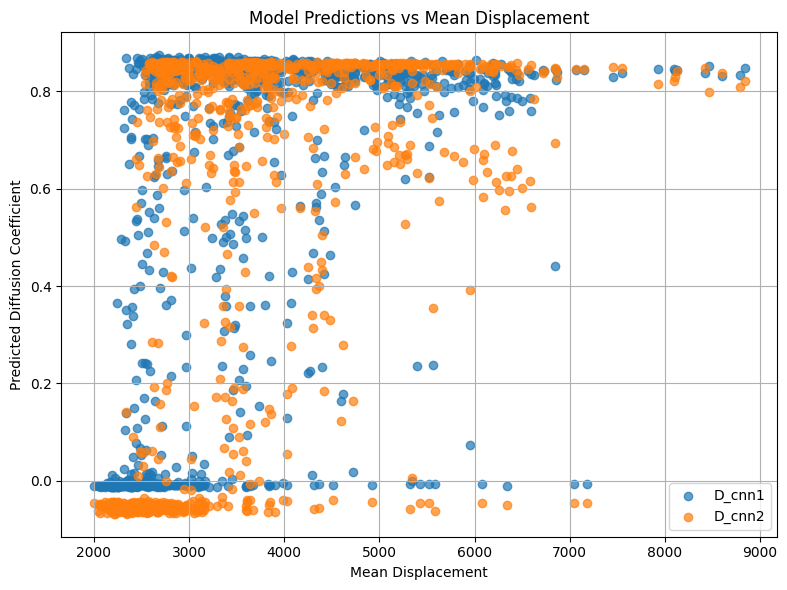

In [15]:
import matplotlib.pyplot as plt

def plotPointsVsFeature(df, features, x_feat, chosen_models):
    # Extract per-track values (as done before)
    track_level_df = df.groupby(level=0).first()[
        features
    ]

    # Plot
    plt.figure(figsize=(8, 6))

    # Loop over each model prediction column
    for column in chosen_models:
        plt.scatter(track_level_df[x_feat], track_level_df[column], label=column, alpha=0.7)

    plt.xlabel('Mean Displacement')
    plt.ylabel('Predicted Diffusion Coefficient')
    plt.title('Model Predictions vs Mean Displacement')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
chosen_models = ['D_resnet', 'D_cnn1', 'D_cnn2']
chosen_models2 = [ 'D_cnn1', 'D_cnn2']

plotPointsVsFeature(df_tracks, ['mean_displacement','mean_max_intensity_over_track', 'D_resnet', 'D_cnn1', 'D_cnn2'], 'mean_max_intensity_over_track', chosen_models2)


In [20]:
# Step 1: Get one row per track with D_deppcnn1 values
track_level_df = df_tracks.groupby(level=0).first()

# Step 2: Filter based on D_deppcnn1 threshold
under_3_ids = track_level_df[track_level_df['D_cnn1'] < 0.1].index
over_3_ids = track_level_df[track_level_df['D_cnn1'] >= 0.1].index

# Step 3: Filter original df_tracks using those IDs
df_under_3 = df_tracks.loc[df_tracks.index.get_level_values(0).isin(under_3_ids)]
df_over_3 = df_tracks.loc[df_tracks.index.get_level_values(0).isin(over_3_ids)]

Correlation between mean_displacement and each model prediction:
D_resnet   -0.123867
D_cnn1      0.190566
D_cnn2      0.364811
Name: mean_max_intensity_over_track, dtype: float64


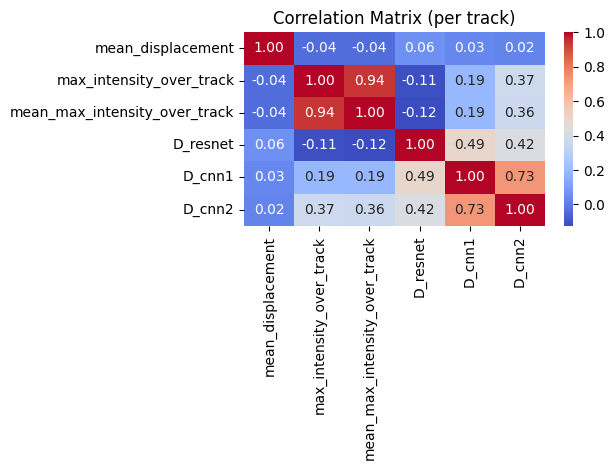

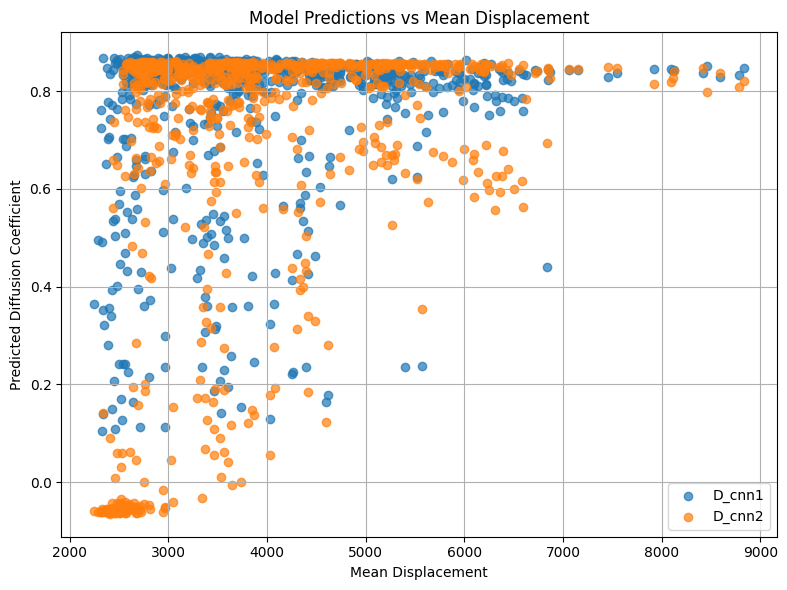

In [21]:
corr_matrix = computeCorrforFeaturesPlotCorr(df_over_3, ['track_id', 'mean_displacement', 'max_intensity_over_track','mean_max_intensity_over_track' ,'D_resnet', 'D_cnn1', 'D_cnn2'])
plotPointsVsFeature(df_over_3, ['mean_displacement','mean_max_intensity_over_track', 'D_resnet', 'D_cnn1', 'D_cnn2'], 'mean_max_intensity_over_track', chosen_models2)


Correlation between mean_displacement and each model prediction:
D_resnet   -0.367547
D_cnn1      0.105423
D_cnn2      0.169253
Name: mean_max_intensity_over_track, dtype: float64


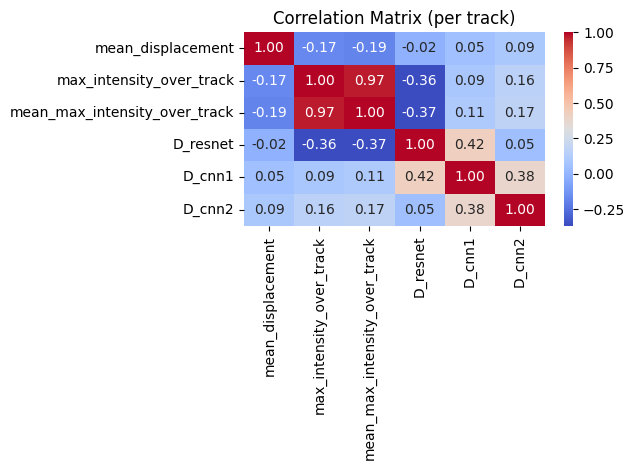

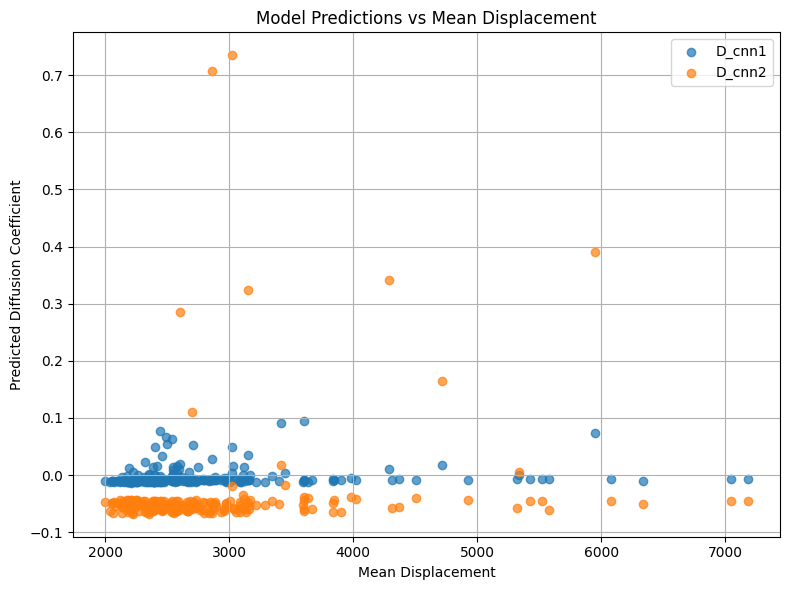

In [22]:
corr_matrix = computeCorrforFeaturesPlotCorr(df_under_3, ['track_id', 'mean_displacement', 'max_intensity_over_track','mean_max_intensity_over_track' ,'D_resnet', 'D_cnn1', 'D_cnn2'])
plotPointsVsFeature(df_under_3, ['mean_displacement','mean_max_intensity_over_track', 'D_resnet', 'D_cnn1', 'D_cnn2'], 'mean_max_intensity_over_track', chosen_models2)


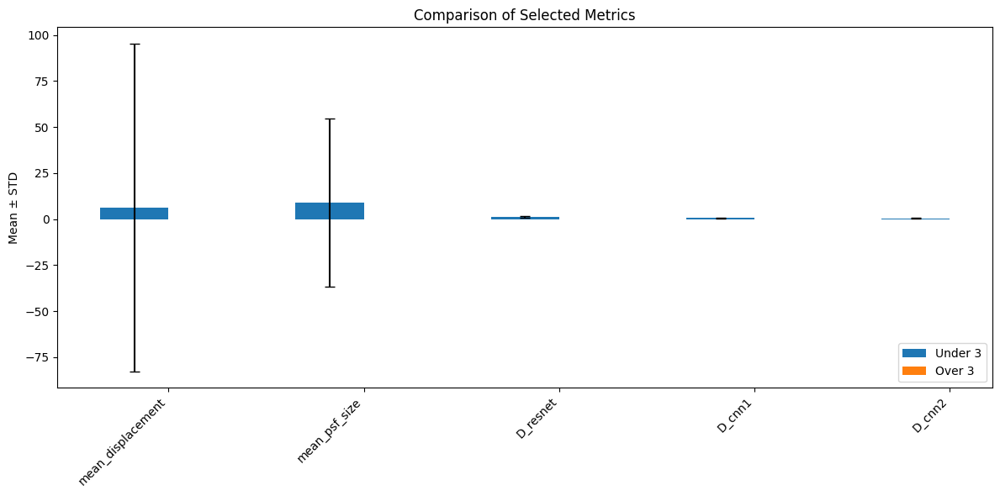

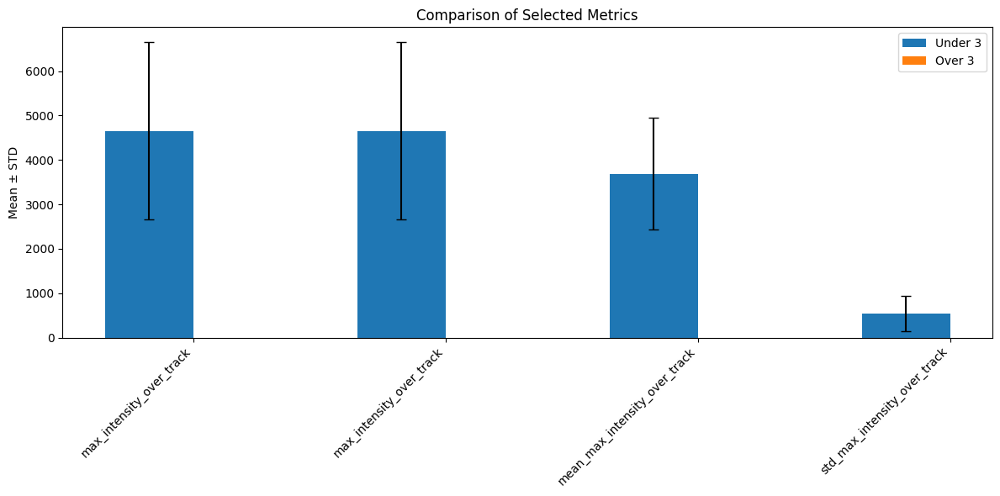

In [19]:
df_under_3_track = df_under_3.groupby(level=0).first()

df_over_3_track = df_over_3.groupby(level=0).first()



plot_comparison_with_std(df_under_3, df_over_3, columns=['mean_displacement','mean_psf_size' ,'D_resnet', 'D_cnn1', 'D_cnn2'])
plot_comparison_with_std(df_under_3, df_over_3, columns=['max_intensity_over_track','max_intensity_over_track','mean_max_intensity_over_track','std_max_intensity_over_track'])

